In [1]:
import math
import collections
import dataclasses
import datetime

import numpy as np
import pandas as pd
# import matplotlib.pyplot as pp

The OWID Covid-19 dataset includes a wide range of metrics, such as cases and death, testing and vaccination data, and some economic data.

The dataset includes data from nearly every country in the world, offering a rare opportunity to analyze global phenomena at both a macro (worldwide) and micro (country or region-specific) level.

COVID-19 is one of the most significant global events of recent history, affecting virtually every person on the planet. The dataset offers the opportunity to study the pandemic's progress and its societal impact in real time.

The dataset is curated by Our World in Data (OWID), a well-respected, reliable source. It gathers data from authoritative organizations like the WHO, CDC, and national health ministries. The methodology for data collection is transparent.

## Cleaning

In [2]:
df = pd.read_csv('compact.csv', dtype_backend='pyarrow')

[Will need to remove some columns.]

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 439944 entries, 0 to 439943
Data columns (total 61 columns):
 #   Column                                      Non-Null Count   Dtype          
---  ------                                      --------------   -----          
 0   country                                     439944 non-null  string[pyarrow]
 1   date                                        439944 non-null  string[pyarrow]
 2   total_cases                                 427250 non-null  double[pyarrow]
 3   new_cases                                   425464 non-null  int64[pyarrow] 
 4   new_cases_smoothed                          424238 non-null  double[pyarrow]
 5   total_cases_per_million                     427250 non-null  double[pyarrow]
 6   new_cases_per_million                       425464 non-null  double[pyarrow]
 7   new_cases_smoothed_per_million              424238 non-null  double[pyarrow]
 8   total_deaths                                427250 non-null  dou

In [4]:
df.date = pd.to_datetime(df.date).convert_dtypes(dtype_backend='pyarrow')

Fix a few things

In [5]:
df.total_cases = df.total_cases.astype('int32[pyarrow]')

In [6]:
df.population = df.population.astype('int64[pyarrow]')

In [7]:
df['total_excess'] = df.excess_mortality_cumulative_absolute

Inspect data

In [8]:
df.country.unique()

<ArrowExtensionArray>
[                                        'Afghanistan',
                                              'Africa',
                                             'Albania',
                                             'Algeria',
                                      'American Samoa',
                                             'Andorra',
                                              'Angola',
                                            'Anguilla',
                                 'Antigua and Barbuda',
                                           'Argentina',
 ...
                                   'Wallis and Futuna',
                                      'Western Sahara',
                                'Winter Olympics 2022',
                                               'World',
                                   'World excl. China',
                   'World excl. China and South Korea',
 'World excl. China, South Korea, Japan and Singapore',
                     

In [9]:
df[df.country == 'World'].continent

427969    <NA>
427970    <NA>
427971    <NA>
427972    <NA>
427973    <NA>
          ... 
429673    <NA>
429674    <NA>
429675    <NA>
429676    <NA>
429677    <NA>
Name: continent, Length: 1709, dtype: string[pyarrow]

select actual countries only, no small countries

In [10]:
df.population

0         40578846
1         40578846
2         40578846
3         40578846
4         40578846
            ...   
439939    16069061
439940    16069061
439941    16069061
439942    16069061
439943    16069061
Name: population, Length: 439944, dtype: int64[pyarrow]

In [56]:
df['percent_fully_vaccinated'] = df.people_fully_vaccinated_per_hundred

In [349]:
smoothed = df.groupby('country').new_cases_smoothed.cumsum().reset_index(level=0, drop=True)
smoothed.name = 'total_cases_smoothed'
df2 = df.merge(smoothed, left_index=True, right_index=True)

Prepare the data a bit. Actual countries only, large countries, countries that reported at least 5 cases

In [350]:
dc = df2[~pd.isnull(df2.continent) & (df2.population > 1e7)].dropna(subset='total_cases').copy()

In [352]:
maxcases_bycountry = dc.groupby('country').total_cases.max()
lessthanfive = maxcases_bycountry[maxcases_bycountry < 5]
lessthanfive

country
North Korea    0
Name: total_cases, dtype: int32[pyarrow]

In [353]:
dc = dc[~dc.country.isin(lessthanfive.index)]

Do this before...

In [355]:
dc = dc[['date', 'country', 'continent', 'total_cases', 'total_deaths', 'total_excess', 'population', 'gdp_per_capita',
         'percent_fully_vaccinated', 'total_cases_smoothed']]

For this project we'll use a modern plotting package, plotly, which can make interactive javascript-based plots that can be exported very easily to web pages.

To give you a taste of what plotly can do, let's look at the impact of the first year of the pandemic in Europe.

In [453]:
europe2020 = df2[(df2.continent == 'Europe') & (df2.date==pd.to_datetime('2020-12-31'))]

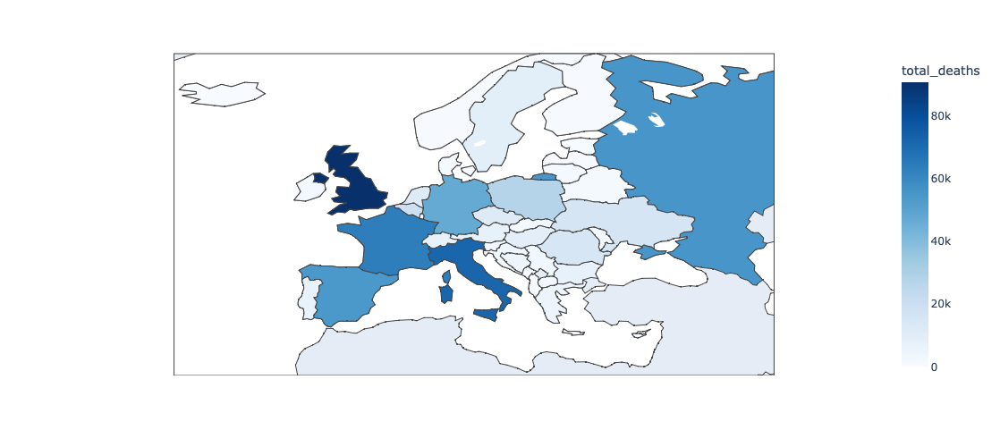

In [463]:
fig = px.choropleth(europe2020, 
                    locations='country',
                    locationmode='country names',
                    color='total_deaths',
                    hover_name='country',
                    color_continuous_scale=px.colors.sequential.Blues)

fig.update_layout(width=800, height=500)
fig.update_geos(lonaxis={'range': [-25, 50]},   # set longitude range
                lataxis={'range': [30, 70]})   # set latitude range

fig.show()

### Summarizing

We'll look at the most recent values of the cumulative quantitities.

In [53]:
final = dc.groupby('country').last()
final

,continent,total_cases,total_deaths,total_excess,population,gdp_per_capita,percentage_fully_vaccinated
country,,,,,,,
Afghanistan,Asia,235214,7998.0,<NA>,40578846,1516.2733,45.270844
Algeria,Africa,272157,6881.0,126117.99,45477391,11198.233,14.251447
Angola,Africa,107481,1937.0,<NA>,35635028,5906.1157,26.965265
Argentina,South America,10102262,130671.0,186306.38,45407904,22461.441,76.860214
Australia,Oceania,11861161,25236.0,36645.2,26200987,51090.26,82.62102
...,...,...,...,...,...,...,...
Venezuela,South America,552695,5856.0,<NA>,28213016,<NA>,53.048817
Vietnam,Asia,11624000,43206.0,<NA>,99680656,11396.531,86.23695
Yemen,Asia,11945,2159.0,<NA>,38222880,<NA>,2.11145


Maybe the most obvious question we can ask of the data is which country had the most cases. There's a nice built-in method to see the largest entries in a series.

In [706]:
final.total_cases.nlargest(10)

country
United States     103436829
China              99379706
India              45043037
France             38997490
Germany            38437756
Brazil             37511921
South Korea        34571873
Japan              33803572
Italy              26826486
United Kingdom     24985434
Name: total_cases, dtype: int32[pyarrow]

This series looks a bit vanilla, and it is not easy to parse... we can do better by converting to a DataFrame.

In [741]:
pd.DataFrame(final.total_cases.nlargest(10))

,total_cases
country,
United States,103436829
China,99379706
India,45043037
France,38997490
Germany,38437756
Brazil,37511921
South Korea,34571873
Japan,33803572
Italy,26826486


...and then styling the numbers:

In [717]:
pd.DataFrame(final.total_cases.nlargest(10)).style.format('{:,d}')

,total_cases
country,
United States,"103,436,829"
China,"99,379,706"
India,"45,043,037"
France,"38,997,490"
Germany,"38,437,756"
Brazil,"37,511,921"
South Korea,"34,571,873"
Japan,"33,803,572"
Italy,"26,826,486"


We'll make a couple of functions to get this more readable look, and we'll stick them into pandas, by adding methods to the Series and DataFrame classes. This is a moderately dirty trick that nevertheless comes useful sometimes.

In [742]:
pd.Series.nice = lambda series, format='{:,.0f}': pd.DataFrame(series).style.format(format)
pd.DataFrame.nice = lambda frame, format='{:,.0f}': frame.style.format(format)

In [743]:
final.total_cases.nlargest(10).nice()

,total_cases
country,
United States,"103,436,829"
China,"99,379,706"
India,"45,043,037"
France,"38,997,490"
Germany,"38,437,756"
Brazil,"37,511,921"
South Korea,"34,571,873"
Japan,"33,803,572"
Italy,"26,826,486"


OK, this is clear. The US had the most cases. What about the most deaths though? Let's look at those and compare with the number of cases. The method `nlargest` generalizes nicely to a DataFrame. The US again.

In [747]:
final.nlargest(10, 'total_deaths')[['total_cases', 'total_deaths']].nice()

,total_cases,total_deaths
country,,
United States,"103,436,829","1,199,064"
Brazil,"37,511,921","702,116"
India,"45,043,037","533,636"
Russia,"24,355,785","403,292"
Mexico,"7,621,860","334,714"
United Kingdom,"24,985,434","232,112"
Peru,"4,526,977","220,975"
Italy,"26,826,486","197,542"
Germany,"38,437,756","174,979"


You may be thinking that a large number of cases and deaths may just be synonymous with a large population, so we can look at cases and deaths per million people. We'll add columns to our dataframe, and make the table again.

In [755]:
final['cases_per_million'] = final.total_cases / (final.population / 1.0e6)
final['deaths_per_million'] = final.total_deaths / (final.population / 1.0e6)

Ah, this significantly changes the picture, with a few smaller countries looking worse.

In [756]:
final.nlargest(10, 'deaths_per_million')[['cases_per_million', 'deaths_per_million']].nice()

,cases_per_million,deaths_per_million
country,,
Peru,"135,233","6,601"
Czechia,"446,842","4,079"
Greece,"547,207","3,789"
Romania,"185,897","3,594"
United States,"302,860","3,511"
United Kingdom,"366,466","3,404"
Brazil,"178,368","3,339"
Italy,"449,965","3,313"
Chile,"276,264","3,209"


A simple division gets us the death rate. Instead of creating a new column as we did for `cases_per_million` and `deaths_per_million`, let me show you how to create a column on the run, while chaining operations.

We also change the print-out format to show a decimal.

Peru has a very high death rate compared to other countries with many deaths. In addition to challenges in health care access, the other reason may be the underreporting of cases, but not deaths.

In [757]:
final.nlargest(10, 'deaths_per_million')[['cases_per_million', 'deaths_per_million']] \
    .assign(death_rate=lambda row: 100 * row.deaths_per_million / row.cases_per_million).nice('{:,.1f}')

,cases_per_million,deaths_per_million,death_rate
country,,,
Peru,"135,232.8","6,601.1",4.9
Czechia,"446,842.2","4,078.5",0.9
Greece,"547,206.9","3,788.8",0.7
Romania,"185,897.5","3,594.4",1.9
United States,"302,859.5","3,510.8",1.2
United Kingdom,"366,466.5","3,404.4",0.9
Brazil,"178,367.9","3,338.5",1.9
Italy,"449,964.6","3,313.4",0.7
Chile,"276,264.4","3,208.9",1.2


Come to think of it, both the number of cases and deaths due to Covid may be suspect statistics for some countries. Cases may go unreported depending on testing and on healthcare logistics, while the criteria for covid-attributed deaths may be different in different countries.

To sidestep these limitations and get a sense of the true impact of the pandemic across the world, the OWID dataset includes numbers for _excess deaths_, which are calculated by comparing cumulative deaths from all causes during the pandemic with a projected baseline of expected deaths based on previous years. This statistic captures not only deaths directly attributed to COVID-19, but also those that may have occurred due to healthcare disruptions, changes in behavior, and other pandemic-related factors.

We'll look at the normalized total excess deaths, computed per million people. This number is not available for all countries. In addition to confirming Peru as a country that was hit heavily, it shows Russia, Bolivia, and central American countries.

In [782]:
final['excess_per_million'] = final.total_excess / (final.population / 1.0e6)

In [783]:
final.nlargest(10, 'excess_per_million')[['cases_per_million', 'deaths_per_million', 'excess_per_million']].nice()

,cases_per_million,deaths_per_million,excess_per_million
country,,,
Russia,"167,302","2,770","9,272"
Peru,"135,233","6,601","6,003"
Bolivia,"100,367","1,854","5,288"
Cuba,"100,694",771,"5,125"
Mexico,"59,262","2,602","5,044"
South Africa,"65,292","1,645","4,960"
Romania,"185,897","3,594","4,822"
Ecuador,"60,509","2,023","4,807"
Ukraine,"134,925","2,678","4,384"


In the next video we'll use visualizations to see if we can make sense of these numbers.

### Modeling

In [664]:
import statsmodels
import statsmodels.api as sm
import statsmodels.formula.api as smf

In [630]:
df2.columns

Index(['country', 'date', 'total_cases', 'new_cases', 'new_cases_smoothed',
       'total_cases_per_million', 'new_cases_per_million',
       'new_cases_smoothed_per_million', 'total_deaths', 'new_deaths',
       'new_deaths_smoothed', 'total_deaths_per_million',
       'new_deaths_per_million', 'new_deaths_smoothed_per_million',
       'excess_mortality', 'excess_mortality_cumulative',
       'excess_mortality_cumulative_absolute',
       'excess_mortality_cumulative_per_million', 'hosp_patients',
       'hosp_patients_per_million', 'weekly_hosp_admissions',
       'weekly_hosp_admissions_per_million', 'icu_patients',
       'icu_patients_per_million', 'weekly_icu_admissions',
       'weekly_icu_admissions_per_million', 'stringency_index',
       'reproduction_rate', 'total_tests', 'new_tests',
       'total_tests_per_thousand', 'new_tests_per_thousand',
       'new_tests_smoothed', 'new_tests_smoothed_per_thousand',
       'positive_rate', 'tests_per_case', 'total_vaccinations',
    

In [796]:
df2['percent_vaccinated'] = df2.people_vaccinated_per_hundred

In [797]:
dc = df2[~pd.isnull(df2.continent) & (df2.population > 1e7)].dropna(subset='total_cases').copy()
maxcases_bycountry = dc.groupby('country').total_cases.max()
lessthanfive = maxcases_bycountry[maxcases_bycountry < 5]
dc = dc[~dc.country.isin(lessthanfive.index)]
dc = dc[['date', 'country', 'continent', 'total_cases', 'total_deaths', 'total_excess', 'population', 'gdp_per_capita',
         'percent_fully_vaccinated', 'percent_vaccinated', 'total_cases_smoothed', 'stringency_index',
         'population_density', 'median_age', 'life_expectancy', 'extreme_poverty', 'human_development_index', 'hospital_beds_per_thousand']]

ANOVA per year

In [798]:
for year in range(2020, 2024):
    data = dc[dc.date.dt.year == year].groupby('country')
    final[f'total_excess_{year}'] = data.total_excess.max() - data.total_excess.min()
    final[f'excess_per_million_{year}'] = final[f'total_excess_{year}'] / (final.population / 1.0e6)
    final[f'percent_fully_vaccinated_{year}'] = data.percent_fully_vaccinated.min()
    final[f'percent_vaccinated_{year}'] = data.percent_vaccinated.min()

excess = final.dropna(subset='excess_per_million').reset_index()
excess['continent'] = excess.continent.astype('category')

In [790]:
print(excess['excess_per_million'].mean())
for year in range(2020, 2024):
    print(year, excess[f'excess_per_million_{year}'].mean())

3299.51039329707
2020 1061.6235953427247
2021 1559.595093222383
2022 572.6755799711948
2023 376.08134458996875


In [804]:
life_expectancy_2020 = {
    'Algeria': 76.3, 'Argentina': 76.7, 'Australia': 83.4, 'Azerbaijan': 75.6, 'Belgium': 81.0, 'Bolivia': 71.4,
    'Brazil': 76.7, 'Canada': 82.3, 'Chile': 80.5, 'Colombia': 77.3, 'Cuba': 78.5, 'Czechia': 79.2, 'Dominican Republic': 74.7,
    'Ecuador': 77.1, 'Egypt': 72.9, 'France': 82.5, 'Germany': 81.0, 'Greece': 82.5, 'Guatemala': 75.0, 'Iran': 76.9, 'Italy': 83.3,
    'Japan': 84.6, 'Jordan': 74.7, 'Kazakhstan': 73.6, 'Malaysia': 75.6, 'Mexico': 75.1, 'Netherlands': 82.5, 'Peru': 77.0,
    'Philippines': 71.7, 'Poland': 78.7, 'Portugal': 81.0, 'Romania': 75.2, 'Russia': 73.1, 'South Africa': 64.1,
    'South Korea': 83.0, 'Spain': 83.1, 'Sweden': 82.6, 'Tajikistan': 73.3, 'Thailand': 77.1, 'Tunisia': 76.5, 'Turkey': 78.6,
    'Ukraine': 72.7, 'United Arab Emirates': 77.7, 'United Kingdom': 81.2, 'United States': 78.5, 'Uzbekistan': 73.0,
}

In [ ]:
# in 2020, nothing explanatory
# in 2021, median_age, life_expectancy 
# in 2022, extreme_poverty, to some extent human_development_index
# in 2023, nothing

In [811]:
excess = excess.merge(pd.DataFrame({'life_expectancy_2020': life_expectancy_2020}), left_on='country', right_index=True)

In [835]:
for year in range(2020, 2024):
    tildemodel = f'excess_per_million_{year} ~ ' + ' + '.join(['continent', 'population', 'gdp_per_capita',
                 'population_density', 'median_age', 'life_expectancy_2020', 'extreme_poverty',
                 'human_development_index', 'hospital_beds_per_thousand'])
    if year > 2020:
        tildemodel = tildemodel + f' + percent_fully_vaccinated_{year} + percent_vaccinated_{year}'

    model = smf.ols(tildemodel, data=excess).fit()
    print(year)
    print(sm.stats.anova_lm(model, typ=2))
    print()

tildemodel = 'excess_per_million ~ ' + ' + '.join(['continent', 'population', 'gdp_per_capita',
                                                   'population_density', 'median_age', 'life_expectancy_2020', 'extreme_poverty',
                                                   'human_development_index', 'hospital_beds_per_thousand', 'percent_fully_vaccinated'])
model = smf.ols(tildemodel, data=excess).fit()
print('overall')
print(sm.stats.anova_lm(model, typ=2))

2020
                                  sum_sq    df         F    PR(>F)
continent                   4.738650e+06   5.0  2.627317  0.047325
population                  4.574518e+05   1.0  1.268158  0.270400
gdp_per_capita              6.030379e+04   1.0  0.167175  0.685983
population_density          5.475619e+05   1.0  1.517963  0.228955
median_age                  5.631299e+05   1.0  1.561121  0.222633
life_expectancy_2020        2.239889e+03   1.0  0.006209  0.937795
extreme_poverty             4.116600e+05   1.0  1.141213  0.295215
human_development_index     4.655069e+02   1.0  0.001290  0.971618
hospital_beds_per_thousand  3.164914e+05   1.0  0.877384  0.357539
Residual                    9.378761e+06  26.0       NaN       NaN

2021
                                     sum_sq    df         F    PR(>F)
continent                      1.948125e+06   5.0  0.748500  0.595203
population                     7.343427e+04   1.0  0.141073  0.710516
gdp_per_capita                 2.625160e+0

/Users/vallis/mambaforge/envs/nanograv311/lib/python3.11/site-packages/statsmodels/base/model.py:1888: ValueWarning:

covariance of constraints does not have full rank. The number of constraints is 5, but rank is 4



In [830]:
import mlxtend.feature_selection
import sklearn.linear_model

In [887]:
year = 2023
excess2 = excess[excess.country != 'Cuba']
X = pd.DataFrame(excess2, columns=['population', 'gdp_per_capita',
                                   'population_density', 'median_age', 'life_expectancy_2020', # 'extreme_poverty',
                                   'human_development_index'])

y = excess2[f'excess_per_million_{year}']

model = sklearn.linear_model.LinearRegression()

sfs = mlxtend.feature_selection.SequentialFeatureSelector(model, k_features=5, forward=True, floating=False, scoring='r2', cv=10)
sfs.fit(X, y)

ValueError: 
All the 10 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
10 fits failed with the following error:
Traceback (most recent call last):
  File "/Users/vallis/mambaforge/envs/nanograv311/lib/python3.11/site-packages/sklearn/model_selection/_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Users/vallis/mambaforge/envs/nanograv311/lib/python3.11/site-packages/sklearn/base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/vallis/mambaforge/envs/nanograv311/lib/python3.11/site-packages/sklearn/linear_model/_base.py", line 678, in fit
    X, y = self._validate_data(
           ^^^^^^^^^^^^^^^^^^^^
  File "/Users/vallis/mambaforge/envs/nanograv311/lib/python3.11/site-packages/sklearn/base.py", line 622, in _validate_data
    X, y = check_X_y(X, y, **check_params)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/vallis/mambaforge/envs/nanograv311/lib/python3.11/site-packages/sklearn/utils/validation.py", line 1162, in check_X_y
    y = _check_y(y, multi_output=multi_output, y_numeric=y_numeric, estimator=estimator)
        ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Users/vallis/mambaforge/envs/nanograv311/lib/python3.11/site-packages/sklearn/utils/validation.py", line 1172, in _check_y
    y = check_array(
        ^^^^^^^^^^^^
  File "/Users/vallis/mambaforge/envs/nanograv311/lib/python3.11/site-packages/sklearn/utils/validation.py", line 957, in check_array
    _assert_all_finite(
  File "/Users/vallis/mambaforge/envs/nanograv311/lib/python3.11/site-packages/sklearn/utils/validation.py", line 122, in _assert_all_finite
    _assert_all_finite_element_wise(
  File "/Users/vallis/mambaforge/envs/nanograv311/lib/python3.11/site-packages/sklearn/utils/validation.py", line 171, in _assert_all_finite_element_wise
    raise ValueError(msg_err)
ValueError: Input y contains NaN.


In [881]:
X.columns.values[list(sfs.k_feature_idx_)]

array(['population', 'gdp_per_capita', 'population_density', 'median_age',
       'life_expectancy_2020'], dtype=object)

In [885]:
X.columns.values[list(sfs.k_feature_idx_)]

array(['population', 'population_density', 'median_age',
       'life_expectancy_2020', 'human_development_index'], dtype=object)

In [756]:
final = dc.groupby('country').last()

final['cases_per_million'] = final.total_cases / (final.population / 1.0e6)
final['deaths_per_million'] = final.total_deaths / (final.population / 1.0e6)
final['excess_per_million'] = final.total_excess / (final.population / 1.0e6)

# final['life_expectancy'] = dc.groupby('country').life_expectancy.first()
final['percent_fully_vaccinated_end2021'] = dc[dc.date < pd.to_datetime('2022-01-01')].groupby('country').percent_fully_vaccinated.max()
final['total_excess_pre2021'] = dc[dc.date < pd.to_datetime('2022-01-01')].groupby('country').total_excess.max()
final['excess_per_million_pre2021'] = final.total_excess_pre2021 / (final.population / 1.0e6)
final['excess_per_million_post2021'] = (final.total_excess - final.total_excess_pre2021) / (final.population / 1.0e6)

excess = final.dropna(subset='excess_per_million').reset_index()
excess['continent'] = excess.continent.astype('category')

In [653]:
colors = excess.continent.map({'Africa': 'skyblue', 'Europe': 'gold', 'North America': 'palegreen',
                              'South America': 'darkgreen', 'Asia': 'coral', 'Oceania': 'teal'})

In [757]:
tildemodel = 'excess_per_million_pre2021 ~ ' + ' + '.join(['continent', 'population', 'gdp_per_capita',
 'percent_fully_vaccinated', 'percent_fully_vaccinated_end2021', 'stringency_index',
 'population_density', 'median_age', 'life_expectancy', 'extreme_poverty',
 'human_development_index', 'hospital_beds_per_thousand'])

In [758]:
model = smf.ols(tildemodel, data=excess).fit()
sm.stats.anova_lm(model, typ=2)

,sum_sq,df,F,PR(>F)
continent,5.290216e+06,5.0,1.064882,0.405143
population,3.832493e+05,1.0,0.385727,0.540661
gdp_per_capita,1.109842e+06,1.0,1.117017,0.301537
percent_fully_vaccinated,1.077827e+06,1.0,1.084794,0.308453
percent_fully_vaccinated_end2021,9.101684e+05,1.0,0.916052,0.348467
stringency_index,9.747923e+03,1.0,0.009811,0.921957
population_density,2.277660e+06,1.0,2.292383,0.143632
median_age,7.133000e+05,1.0,0.717911,0.405561
life_expectancy,1.514392e+07,1.0,15.241807,0.000714
extreme_poverty,9.898036e+05,1.0,0.996202,0.328617


In [672]:
tildemodel = 'excess_per_million ~ ' + ' + '.join(['continent', 'population', 'gdp_per_capita',
 'percent_fully_vaccinated', 'stringency_index',
 'population_density', 'median_age', 'life_expectancy', 'extreme_poverty',
 'human_development_index', 'hospital_beds_per_thousand'])

In [676]:
model = smf.ols(tildemodel, data=excess).fit()

In [677]:
sm.stats.anova_lm(model, typ=2)

,sum_sq,df,F,PR(>F)
continent,6.436351e+06,5.0,1.241598,0.320904
population,1.577834e+06,1.0,1.521852,0.229285
gdp_per_capita,3.051274e+06,1.0,2.943014,0.099134
percent_fully_vaccinated,4.193430e+04,1.0,0.040446,0.842305
stringency_index,8.470823e+04,1.0,0.081703,0.777456
population_density,7.966039e+05,1.0,0.768340,0.389421
median_age,1.217940e+06,1.0,1.174727,0.289201
life_expectancy,1.367815e+07,1.0,13.192849,0.001327
extreme_poverty,9.756343e+05,1.0,0.941019,0.341691
human_development_index,4.117858e+06,1.0,3.971755,0.057758


In [700]:
fit = smf.ols('excess_per_million ~ gdp_per_capita + life_expectancy + human_development_index', data=excess).fit()
np.sqrt(fit.mse_resid), fit.rsquared, fit.fvalue

(1220.5925258900738, 0.4473545531527896, 11.062871493167451)

In [692]:
fit = smf.ols('excess_per_million ~ gdp_per_capita + life_expectancy + human_development_index', data=excess).fit()
np.sqrt(fit.mse_resid), fit.rsquared, fit.fvalue

(1220.5925258900738, 0.4473545531527896, 11.062871493167451)

In [693]:
fit = smf.ols('excess_per_million ~ 1', data=excess).fit()
np.sqrt(fit.mse_resid), fit.rsquared, fit.fvalue

(1591.1934614782879, 0.0, nan)

In [613]:
fit = smf.ols('excess_per_million ~ continent', data=excess).fit()
np.sqrt(fit.mse_resid), fit.rsquared, fit.fvalue

(1434.8088279561803, 0.2772475263948271, 3.0687964305332303)

In [618]:
fit = smf.ols('excess_per_million ~ continent + population', data=excess).fit()
np.sqrt(fit.mse_resid), fit.rsquared, fit.fvalue

(1393.4125516464142, 0.33539200901579624, 3.2802013941696506)

In [623]:
fit = smf.ols('excess_per_million ~ continent + population + percent_fully_vaccinated', data=excess).fit()
np.sqrt(fit.mse_resid), fit.rsquared, fit.fvalue

(1332.4487986734734, 0.40785758441968867, 3.739107301639649)

In [638]:
fit = smf.ols('excess_per_million ~ continent + population + percent_fully_vaccinated + gdp_per_capita', data=excess).fit()
np.sqrt(fit.mse_resid), fit.rsquared, fit.fvalue

(1193.5652595244705, 0.536001937791221, 5.198316364897219)

In [647]:
fit = smf.ols('excess_per_million ~ continent + population + percent_fully_vaccinated + gdp_per_capita + stringency_index', data=excess).fit()
np.sqrt(fit.mse_resid), fit.rsquared, fit.fvalue

(1209.3642319579358, 0.5368692568118141, 4.508068009540761)

In [ ]:
fit = smf.ols('excess_per_million ~ continent + gdp_per_capita + population + percent_fully_vaccinated + stringency_index', data=excess).fit()
np.sqrt(fit.mse_resid), fit.rsquared, fit.fvalue

In [643]:
fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:     excess_per_million   R-squared:                       0.537
Model:                            OLS   Adj. R-squared:                  0.418
Method:                 Least Squares   F-statistic:                     4.508
Date:                Tue, 15 Oct 2024   Prob (F-statistic):           0.000555
Time:                        17:06:07   Log-Likelihood:                -377.60
No. Observations:                  45   AIC:                             775.2
Df Residuals:                      35   BIC:                             793.3
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
==============================================================================================
                                 coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------
Intercept                   3829.3006    817.910      4.682      0.000    2168.854    5489.747
continent[T.Asia]            116.8800    810.091      0.144      0.886   -1527.692    1761.452
continent[T.Europe]         2201.2162    827.789      2.659      0.012     520.715    3881.718
continent[T.North America]   248.8668    885.593      0.281      0.780   -1548.982    2046.715
continent[T.Oceania]         557.5063   1503.480      0.371      0.713   -2494.720    3609.733
continent[T.South America]  2412.7050   1014.390      2.378      0.023     353.383    4472.027
population                  9.994e-06    3.3e-06      3.031      0.005     3.3e-06    1.67e-05
percent_fully_vaccinated     -26.4287     16.807     -1.572      0.125     -60.548       7.691
gdp_per_capita                -0.0219      0.017     -1.301      0.202      -0.056       0.012
stringency_index               4.8888     19.096      0.256      0.799     -33.877      43.655
==============================================================================
Omnibus:                       12.805   Durbin-Watson:                   1.987
Prob(Omnibus):                  0.002   Jarque-Bera (JB):               14.402
Skew:                           1.012   Prob(JB):                     0.000746
Kurtosis:                       4.893   Cond. No.                     8.75e+08
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 8.75e+08. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

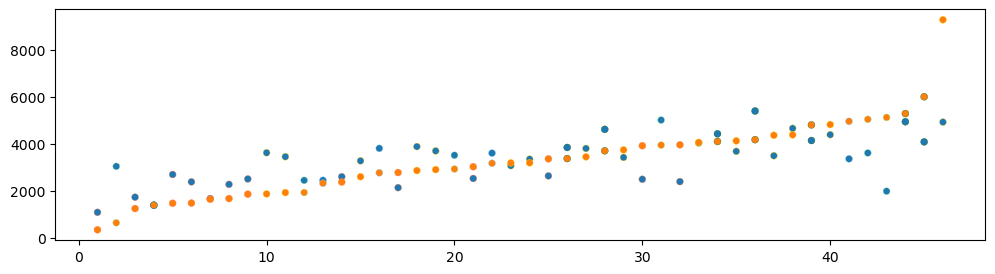

In [710]:
pp.figure(figsize=(12,3))
pp.scatter(excess.excess_per_million.rank(), cmodel.predict(excess),
           color='C0', s=25, edgecolor=colors, linewidth=0.25);
pp.scatter(excess.excess_per_million.rank(), excess.excess_per_million,
           color='C1', s=25, edgecolor=colors, linewidth=0.25);

<Axes: xlabel='date'>

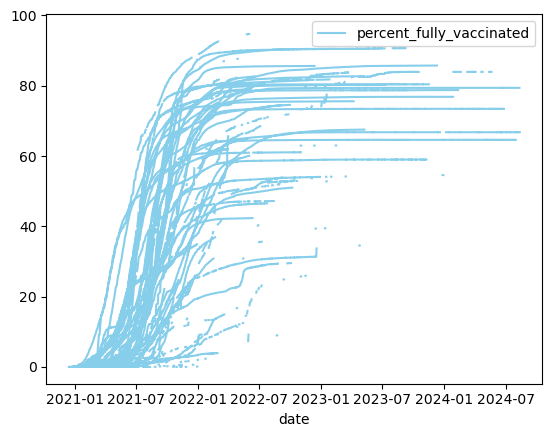

In [714]:
dc.plot(x='date', y='percent_fully_vaccinated', color=colors)

ValueError: 0       skyblue
1     darkgreen
2          teal
3         coral
4          gold
5     darkgreen
6     darkgreen
7     palegreen
8     darkgreen
9     darkgreen
10    palegreen
11         gold
12    palegreen
13    darkgreen
14      skyblue
15         gold
16         gold
17         gold
18    palegreen
19        coral
20         gold
21        coral
22        coral
23        coral
24        coral
25    palegreen
26         gold
27    darkgreen
28        coral
29         gold
30         gold
31         gold
32         gold
33      skyblue
34        coral
35         gold
36         gold
37        coral
38        coral
39      skyblue
40        coral
41         gold
42        coral
43         gold
44    palegreen
45        coral
Name: continent, dtype: category
Categories (6, string[pyarrow]): [skyblue, coral, gold, palegreen, teal, darkgreen] is not a valid value for color

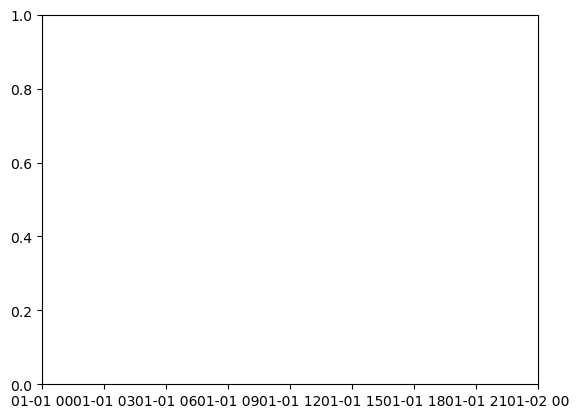

In [712]:
pp.plot(dc.date, dc.percent_fully_vaccinated, color=colors, s=25, edgecolor='k', linewidth=0.25);

### Plotting

#### Explore

In [16]:
pd.Series.nice = lambda series, format='{:,.0f}': pd.DataFrame(series).style.format(format)
pd.DataFrame.nice = lambda frame, format='{:,.0f}': frame.style.format(format)

In [60]:
final = dc.groupby('country').last()

final['cases_per_million'] = final.total_cases / (final.population / 1.0e6)
final['deaths_per_million'] = final.total_deaths / (final.population / 1.0e6)
final['excess_per_million'] = final.total_excess / (final.population / 1.0e6)

Looking at the countries with the most excess deaths per million, we may ask what they have in common. Let's explore by making a few plots.

In [18]:
final.nlargest(15, 'excess_per_million')[['cases_per_million', 'deaths_per_million', 'excess_per_million']].nice()

,cases_per_million,deaths_per_million,excess_per_million
country,,,
Russia,"167,302","2,770","9,272"
Peru,"135,233","6,601","6,003"
Bolivia,"100,367","1,854","5,288"
Cuba,"100,694",771,"5,125"
Mexico,"59,262","2,602","5,044"
South Africa,"65,292","1,645","4,960"
Romania,"185,897","3,594","4,822"
Ecuador,"60,509","2,023","4,807"
Ukraine,"134,925","2,678","4,384"


For this project we'll use a modern plotting package, plotly, which can make interactive javascript-based plots that can be exported very easily to web pages.

In [19]:
import plotly.express as px

In [27]:
# map continents to colors
colors = final.continent.map({'Africa': 'skyblue', 'Europe': 'gold', 'North America': 'palegreen',
                              'South America': 'darkgreen', 'Asia': 'coral', 'Oceania': 'teal'})

So is population predictive? Or is a continent especially bad? Not really. (show plot)

Note how plotly creates nice scaled axis ticks, picks colors for the categorical variable, and creates a legend. With plotly every detail can be tuned or customized, but the defaults are usually pleasant.

Note also that hovering over the points tell us the values on the axes. We use the country name, which is the index of the dataframe, to label the hover tooltip.

In [521]:
excess = final.dropna(subset='excess_per_million')

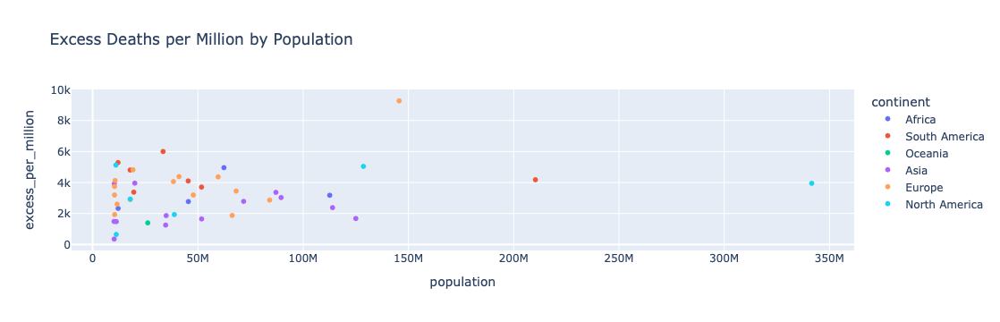

In [523]:
fig = px.scatter(excess, x='population', y='excess_per_million', color='continent',
                 hover_name=excess.index, title='Excess Deaths per Million by Population')
fig.show()

What about income? Not very predictive either. The plotly graph has a number of interactive controls that let us zoom and pan.

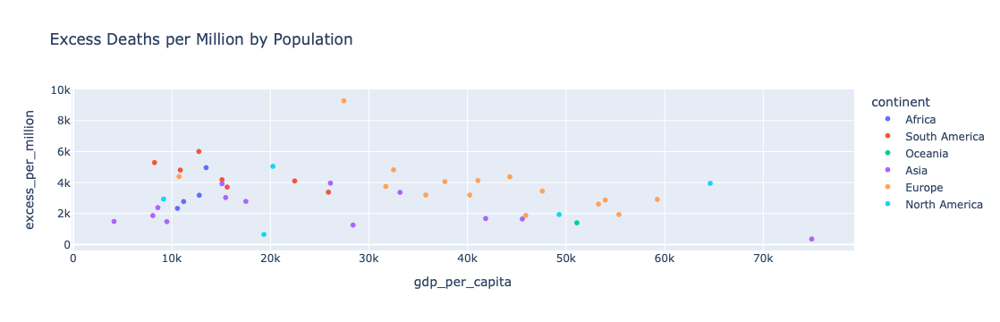

In [524]:
fig = px.scatter(excess, x='gdp_per_capita', y='excess_per_million', color='continent',
                 hover_name=excess.index, title='Excess Deaths per Million by Population')
fig.show()

OK... surely vaccinations will be indicative? They're not.

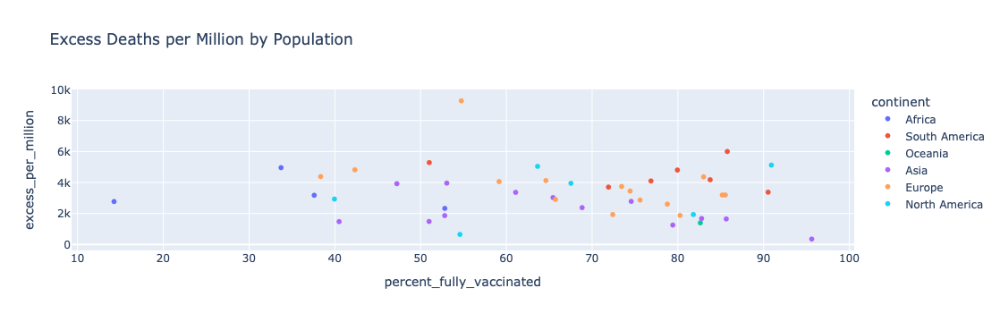

In [525]:
fig = px.scatter(excess, x='percent_fully_vaccinated', y='excess_per_million', color='continent',
                 hover_name=excess.index, title='Excess Deaths per Million by Population')
fig.show()

#### Histories

Of course, most of the deaths may have happened before vaccinations were available. To examine this, we'll have to look at pandemic histories for each individual country.

Here's a plot of total_cases as a function of date, grouped and colored by country. A decent plot, but hard to see much, other than the large number of cases in the USA across the years and in China from 2023.

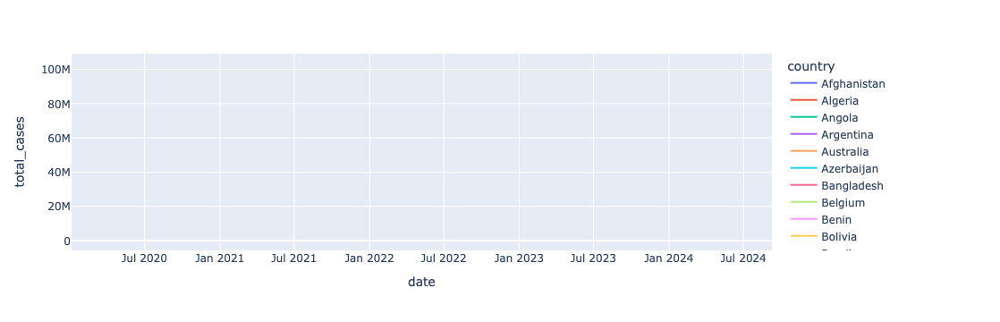

In [246]:
fig = px.line(dc, x='date', y='total_cases', color='country')
fig.show()

Let's focus on the first two years.

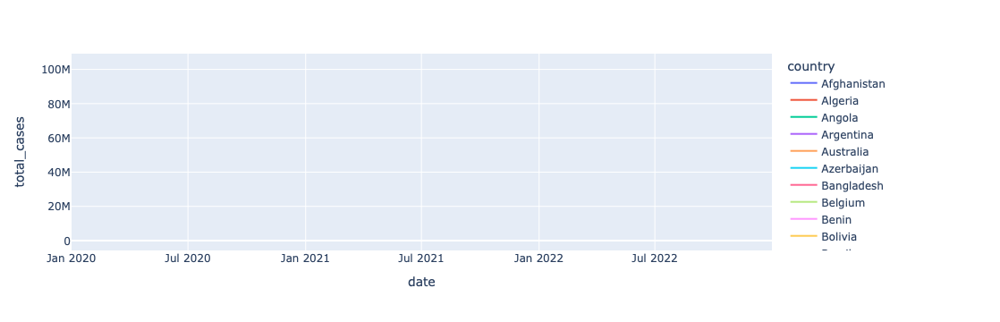

In [247]:
fig = px.line(dc, x='date', y='total_cases', color='country')
fig.update_xaxes(range=['2020-1-1','2022-12-31'])
fig.show()

For one thing, the trends are obscured by the different times at which the pandemic began in each state. Let's fix that.

We find the date at which each country reached at least 5 total cases. This is a bit tricky in pandas, so for once let me show you an example of what not to do.

We'd be tempted to group by country, then apply our condition, but a grouped series does not support that. I searched the documentation for a while on a way to fix this, but it's just awkward.

In [526]:
dc.groupby('country').total_cases >= 5

TypeError: '>=' not supported between instances of 'SeriesGroupBy' and 'int'

Instead we can filter first, then group, and take the first row.

In [527]:
dc[dc.total_cases >= 5].groupby('country').head(1)

,date,country,continent,total_cases,total_deaths,total_excess,population,gdp_per_capita,percent_fully_vaccinated,total_cases_smoothed,t
74,2020-03-15 00:00:00,Afghanistan,Asia,7,0.0,<NA>,40578846,1516.2733,<NA>,1.857143,0
5206,2020-03-08 00:00:00,Algeria,Africa,19,0.0,<NA>,45477391,11198.233,<NA>,3.571429,0
10377,2020-04-05 00:00:00,Angola,Africa,10,0.0,<NA>,35635028,5906.1157,<NA>,1.428572,0
15484,2020-03-08 00:00:00,Argentina,South America,22,1.0,<NA>,45407904,22461.441,<NA>,3.142857,0
24014,2020-02-02 00:00:00,Australia,Oceania,12,0.0,-13.200005,26200987,51090.26,<NA>,5.142857,0
...,...,...,...,...,...,...,...,...,...,...,...
421368,2020-03-15 00:00:00,Venezuela,South America,21,0.0,<NA>,28213016,<NA>,<NA>,3.0,0
423039,2020-02-02 00:00:00,Vietnam,Asia,6,0.0,<NA>,99680656,11396.531,<NA>,2.571429,0
434928,2020-05-03 00:00:00,Yemen,Asia,10,2.0,<NA>,38222880,<NA>,<NA>,2.285714,0
436606,2020-03-29 00:00:00,Zambia,Africa,28,0.0,<NA>,20152934,3365.8738,<NA>,5.714286,0


This is what we need. We restore the country as the index and keep the date only. We'll call this the t0 of the pandemic in each country.

In [252]:
t0 = dc[dc.total_cases >= 5].groupby('country').head(1).set_index('country').date
t0

country
Afghanistan    2020-03-15 00:00:00
Algeria        2020-03-08 00:00:00
Angola         2020-04-05 00:00:00
Argentina      2020-03-08 00:00:00
Australia      2020-02-02 00:00:00
                      ...         
Venezuela      2020-03-15 00:00:00
Vietnam        2020-02-02 00:00:00
Yemen          2020-05-03 00:00:00
Zambia         2020-03-29 00:00:00
Zimbabwe       2020-03-29 00:00:00
Name: date, Length: 93, dtype: timestamp[ns][pyarrow]

And we'll compute the time from the appropriate t0 for each row in our dataset. Here we're applying an operation to every row with `apply`, and creating a new column in the dataset. `axis = 1` is needed here, otherwise pandas would apply the function to the columns.

This is a slow operation; in general it's best to apply operations to columns, not rows. We could have reorganized this computation to do so by merging dataframes, but sometimes going the easier, slower way is just too convenient.

In [359]:
dc['t'] = dc.apply(lambda row: row.date - t0.loc[row.country], axis=1)
dc['t']

4         -70 days
5         -69 days
6         -68 days
7         -67 days
8         -66 days
            ...   
439939   1620 days
439940   1621 days
439941   1622 days
439942   1623 days
439943   1624 days
Name: t, Length: 158937, dtype: timedelta64[ns]

Very good. We'd better convert these time deltas to integers though, otherwise we'll have trouble plotting.

In [360]:
dc['t'] = dc.t.dt.days

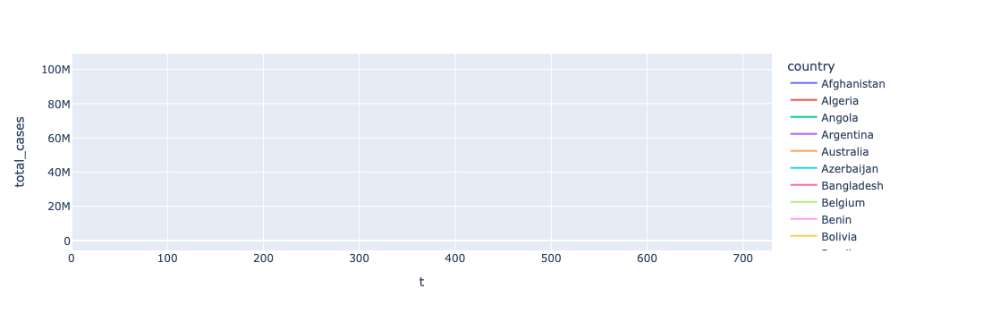

In [284]:
fig = px.line(dc, x='t', y='total_cases', color='country')
fig.update_xaxes(range=[0, 2*365])
fig.show()

Pandemics develop exponentially (at least at the start), so it's appropriate to plot these numbers logarithmically.

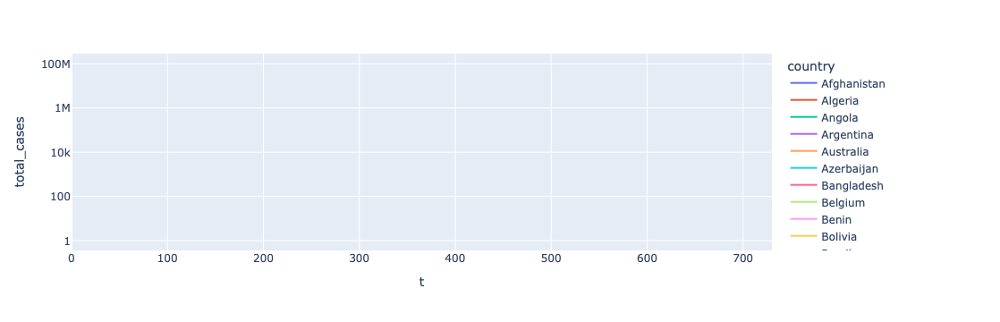

In [281]:
fig = px.line(dc, x='t', y='total_cases', color='country', log_y=True)
fig.update_xaxes(range=[0, 2*365])
fig.update_layout(width=700)
fig.show()

We're getting there, and interactivity helps make sense of this. There are many too traces though, too much is happening. Effective visualization often requires a careful selection of the data we wish to show.

We can concentrate on larger countries, and on the first six months of the epidemic.}

In [408]:
focus = dc[(dc.population > 5e7) & (dc.date < pd.to_datetime('2020-06-30'))]

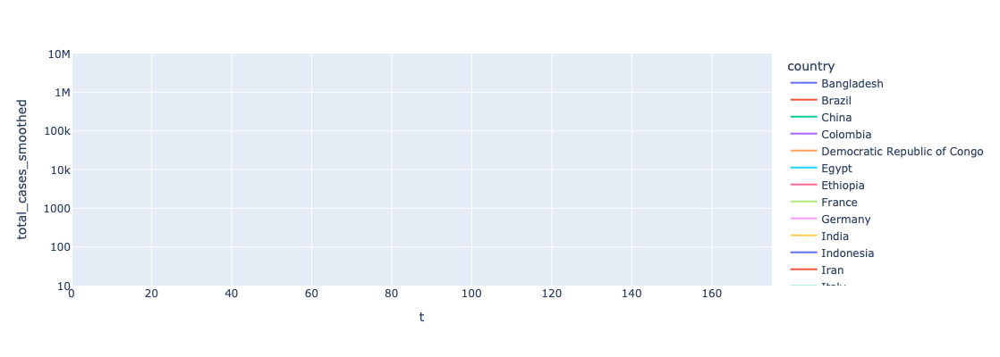

In [423]:
fig = px.line(focus, x='t', y='total_cases_smoothed', color='country', log_y=True)
fig.update_xaxes(range=[0, 175]); fig.update_yaxes(range=[1,7])
fig.update_layout(width=800, height=400)
fig.show()

This is almost publication ready. We recolor by continent (and add the country name to the tooltip that we get when we hover), change the color scheme and the axis names.

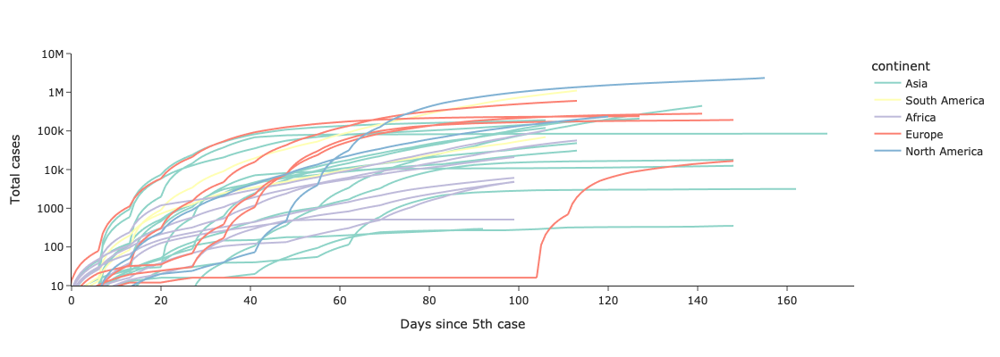

In [528]:
fig = px.line(focus, x='t', y='total_cases_smoothed', color='continent', log_y=True,
              hover_name='country', template='simple_white', color_discrete_sequence=px.colors.qualitative.Set3)
fig.update_xaxes(range=[0, 175], title='Days since 5th case')
fig.update_yaxes(range=[1, 7], title='Total cases')
fig.update_layout(width=600, height=400)

fig.show()

Output to HTML

In [529]:
fig.write_html('cases.html')

In [530]:
!open cases.html